<img src="../biospytial.png" alt="Drawing" style="width: 500px;"/>

# Working example

This section is a case study for analysing the frequency of coexistent taxonomic groups in all
the available dataset restricted to arbitrarily chosen branches of the Tree of Life and included in
a list of threatened species. These type of analyses are important in conservation studies, where
the characterisation of umbrella (or other surrogate) species constitute the basis for protecting a
significant number of associated species [5], [19]. To account for this effect, we chose the jaguar
(Panthera onca) as the species of interest. This due to its preference for undisturbed ecosystems
[82] and its wide geographic requiremental range; $181±4km^2$ for females and $431±152km^2$ males
[15]. We use the IUCN Red List of Threatened Species (Red List) [41] to account for the propor
tion of species (critically endangered, endangered or vulnerable) associated with the presence of
jaguars in a 4 t h degree neighbourhood using the 4km resolution grid described above. For do
ing so, we first calculate the local taxonomic tree for each cell-type node. The resulting trees are
aggregated into a single tree that contains the union of all the nodes found in the local trees. The
aggregated tree contains all the known co-occurrences of jaguar in a neighbourhood of degree 4 th .
We filter this tree to select only the nodes that match the Red List of threatened species and create
a new tree object using the selected nodes, an operation know as trimming. We rank all the node
of the resulting tree using the frequency of occurring at each neighboring cell, in order to provide
an estimate of which nodes co-occur more often with jaguars. Finally, we provide methods for
interactive visualisations of the spatial data and the network structure.
To show the capabilities of the engine we decided to process a reasonable number of cells and
trees. The time for executing the following example varies considerably depending on the group of
interest, the size of the neighbourhood and the computer platform. A quick workaround to speed
up the processes is to reduce the number of neighbouring cells (order of the neighbourhood), e.g.
use degree = 1.


## Obtaining and runing the engine
The engine is composed of three modules that can be downloaded and run as docker containers.
* [Graph Storage and Processing Unit ](https://hub.docker.com/r/molgor/postgis_biospytial)
* [Biospytial Computing Engine](https://hub.docker.com/r/molgor/biospytial)
* [Relational Geoprocessing Unit](https://hub.docker.com/r/molgor/neo4j_biospytial)

The source code can be downloaded from [here](https://github.com/molgor/biospytial)



<div class="alert alert-block alert-info">
<b>Note:</b> 
To show the capabilities of the engine we decided to process a fair amount of Cells and Trees. The processing of this will take around 35 minutes in a 4 core computer.
It is possible to reduce the number of data to fasten the computation (for demonstration purposes). For doing this, change the order of the neighbourhood to 1. (See below)
 For a fast computation reduce the order level to 1   
</div>

In [1]:
## Import modules and libraries
%matplotlib inline
import sys
sys.path.append('/apps')
import django
django.setup()
import numpy as np
import matplotlib.pyplot as plt
## Jupyter only, use for displaying utf8 names. Deprecated in Biospytial 3. 
reload(sys)
sys.setdefaultencoding("utf-8")

INFO Merging Trees
INFO Sorting nodes in taxonomic levels by counts on frequencies
INFO Sorting nodes in taxonomic levels by counts on frequencies
INFO Sorting nodes in taxonomic levels by counts on frequencies
INFO Sorting nodes in taxonomic levels by counts on frequencies


<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/2/21/Junior-Jaguar-Belize-Zoo.jpg/800px-Junior-Jaguar-Belize-Zoo.jpg" alt="Drawing" style="width: 500px;"/>

## Selecting the *Jaguar* node

We begin by selecting the node in the Tree of Life corresponding to the genus Panthera. This
node is linked to some Species and Family type nodes and also has links to Occurrence nodes,
where the information of location and time is stored. To start the traversal we need to first select
this node. To do so we use the function pickNode using the following syntax:
    
```python
pickNode(<Type of node>,'name of the node')
```
In the example below we see how to load the pickNode function and the appropriate node class
(in this case Genus ).



In [2]:
from drivers.graph_models import Genus, graph, pickNode
jaguars = pickNode(Genus,"Panthera")



The variable *jaguars* is now an instance of the class **Genus**. As such, it has associated attributes and methods.
string representation is the following:

In [3]:
jaguars

<TreeNode type: Genus id = 2435194 name: Panthera>

We proceed to traverse through all the cells where any occurrence of the Panthera genus was
registered. 
To do so we call the attribute *cells*. This attribute is abstracted with lazy evaluation.
Therefore, to fetch all the associated data we need to convert the object into a list (or a partial list
using an iterator). The time features shows how much time it takes to extract all the information.


In [4]:
%time cells = list(jaguars.cells)
print("cells has %s elements"%len(cells))

The resulting list has cell instances, each one connected to other cells by the relation: ’IS
NEIGHBOUR OF’. Accessing their related cells is achieved by the method:
```python
cell.getNeighbours(with_center=[Boolean],order=[Int])
```
where the parameter *with_center* returns the center of the neighborhood, and the parameter
*order* the size (in number of cells) of the neighborhood. 
In our case, we apply this method for each cell using a map function.


<div class="alert alert-block alert-info">
<b>Note:</b> 
 For a fast computation reduce the order level to 1   
</div>
<a id="optimize"></a>



In [5]:
%time neighbours = map(lambda cell : cell.getNeighbours(with_center=True,order=1), cells)

The neighbours object is a list of a list of cells. We need to reduce this nested list into a single one
(flatten) with all the resulting cell instances.

In [6]:
# remmeber that the + operator merges two lists
neighbours = reduce(lambda list_a , list_b : list_a + list_b, neighbours)

The resulting neighbours list now has 2497 Cell nodes. In the current implementation the
name of the Grid (where all the Cells are contained) is called *mex4km*. We can display the first
three elements as this:

In [7]:
neighbours[:3]

[< Cell-mex4km id = 234457 >,
 < Cell-mex4km id = 234686 >,
 < Cell-mex4km id = 234684 >]

## Converting cells to local taxonomic trees
We obtain the Tree of Life inside each Cell node by extracting the occurrences inside each cell
(using the method 'occurrencesHere' ) and plugging them into the *TreeNeo* constructor. The name
*TreeNeo* is used because the storage backend is the Neo4j graph database.


In [8]:
from drivers.tree_builder import TreeNeo
cell_1 = neighbours[1]
tree_1 = TreeNeo(cell_1.occurrencesHere())

In [9]:
tree_1

<LocalTree Of Life | Root: LUCA - n.count : 3- >

The `n.count` value indicates the number of total occurrences.
We can generate all the trees iteratively using a maping the `TreeNeo(cell.occurrencesHere())` through all neighbouring cells. This may take some time depending on the number of cells and number of occurrences on each cell. For reducing this time go to [Selecting order of neighbourhood](#optimize)

In [10]:
%time sample_trees = map(lambda cell : TreeNeo(cell.occurrencesHere()),neighbours)

As in the last example, we can see basic information as object description. Here showing the
first four elements. 
`sample_trees` is a list of Trees. We can display some first elements as before.


In [11]:
sample_trees[:4]

[<LocalTree Of Life | No record available: - n.count : 0- >,
 <LocalTree Of Life | Root: LUCA - n.count : 3- >,
 <LocalTree Of Life | Root: LUCA - n.count : 151- >,
 <LocalTree Of Life | Root: LUCA - n.count : 5- >]

It is possi-
ble to have empty trees, when no occurrences were found. This is showed with the text: `No record available` 

## Exploratory analysis on a single Tree
We select a tree in this example and explore informative data.

In [12]:
tree = sample_trees[1]

The object `tree` wraps the entire tree structure. 
All `Tree` objects have as starting node the root of the Taxonomic Tree which represents all known life. 

In [13]:
root = tree.node

`Root` node is similar to `Family` node, `Genus` node, etc. They all belong to the class: `TreeNode`. 

We can access a specific child node with the prefix `to_[name of taxon]`.  
For example, accessing the node 'Animalia' can be done with: 

In [14]:
root.to_Animalia


<LocalTree | Kingdom: Animalia - n.count : 2- | AF: 0.05>

The resulting node (Animalia) is again of a `TreeNode` type. We can explore this node until we reach no children.
<div class="alert alert-block alert-warning">
<b>Note:</b> There could be errors if the selected tree is different from this example. This could happen, for example, if a reduction in the size of the neighbourhood was done.
</div>

### Traverse by children nodes
We can concatenate this method until the children attribute is empty. If running Biospytial in
an interactive session (like a Jupyter notebook or iPython) we can use the key [TAB] to autocom-
plete and show the available nodes. For example, the family of rodents *Muridae*.

<div class="alert alert-block alert-success">
<b>Hint:</b>
If we are running Biospytial in an interactive session (like Jupyter notebook or iPython)we can use the key [TAB] to autocomplete and show the available nodes.
</div>


In [15]:
root.to_Animalia.to_Chordata.to_Mammalia.to_Rodentia.to_Muridae

<LocalTree | Family: Muridae - n.count : 2- | AF: 0.05>

### Tree traversal by taxonomic level
The taxonomic levels (e.g. families, orders, etc) are stored as atributes
of the *TreeNeo* class.
For example, to see available `phyla` in this tree do:


In [16]:
tree.phyla

[<LocalTree | Phylum: Chordata - n.count : 2- | AF: 0.05>,
 <LocalTree | Phylum: Magnoliophyta - n.count : 1- | AF: 0.05>]

and for some families inside this tree.

In [17]:
tree.families[:5]

[<LocalTree | Family: Annonaceae - n.count : 1- | AF: 0.05>,
 <LocalTree | Family: Muridae - n.count : 2- | AF: 0.05>]

## Tree operations
Tree objects allow symbolic operations for adding (merging) and intersecting other tree ob-
jects. These operations are currently implemented as `sum (+)` and `intersection (&)` . These
operations can be applied to arbitrary number of trees and it is useful in comparative studies that
require the calculus of (α, β, γ)-diversity using a combination of these operation [89]. Mathemati-
cally, these operations are equivalent theoretic set operations acting at the occurrence level. As an
example consider the following: 

Let `t1` and `t2` two trees from the list of `sampled trees`

In [18]:
t1 = sample_trees[1]
t2 = sample_trees[2]

### Addition
Adding trees is equivalent to merging them. That is, making the union of all the nodes (inter
nodes and leaves). The tree objects ( `TreeNode` and `TreeNeo` classes) allow the use of the + opera-
tion. For example, obtaining the merge tree of t1 and t2 is achieved with:
Suming two trees is equivalent to merge them

In [19]:
t3 = t1 + t2 

For example the classes of t1 and t2 are:

In [20]:
t1.classes

[<LocalTree | Class: Mammalia - n.count : 2- | AF: 0.05>,
 <LocalTree | Class: Magnoliopsida - n.count : 1- | AF: 0.05>]

In [21]:
t2.classes

[<LocalTree | Class: Protosteliomycetes - n.count : 2- | AF: 0.05>,
 <LocalTree | Class: Myxomycetes - n.count : 112- | AF: 0.05>,
 <LocalTree | Class: Agaricomycetes - n.count : 4- | AF: 0.05>,
 <LocalTree | Class: Liliopsida - n.count : 8- | AF: 0.05>,
 <LocalTree | Class: Magnoliopsida - n.count : 25- | AF: 0.05>]

In [22]:
t3.classes

[<LocalTree | Class: Protosteliomycetes - n.count : 2- | AF: 0.05>,
 <LocalTree | Class: Myxomycetes - n.count : 112- | AF: 0.05>,
 <LocalTree | Class: Agaricomycetes - n.count : 4- | AF: 0.05>,
 <LocalTree | Class: Mammalia - n.count : 2- | AF: 0.05>,
 <LocalTree | Class: Liliopsida - n.count : 8- | AF: 0.05>,
 <LocalTree | Class: Magnoliopsida - n.count : 26- | AF: 0.05>]

### Intersection
Intersection is applied through the & operation and it is equivalent to the intersection of sets
with the difference that it is only applied to the leaf nodes, that is, the Occurrence nodes. Once
the leaf nodes are selected, the algorithm propagates through the parent nodes until it reaches
the root node. To see the formalization of the data structure go to supplementary materials II. For
obtaining the intersection of two trees do:


In [23]:
t = t1 & t2
t

<LocalTree Of Life | No record available: - n.count : 0- >

In this case, the intersection is empty because the Occurrences are overlaid in a regular lattice
that partition the space, i.e. the cells are disjoint. See supplementary materials II for a formal
definition.

### Efficient addition of trees from a list of cells
We can use the sum iteratively as in a folding sum to obtain a Tree object representing all the areas definied in a list of Cells. 
```python
big_tree = reduce(lambda a , b : a+b , sample_trees)
```
However this method is not efficient. In each step, a new tree is created and the internal logic
to generate the union of all the intermediate nodes can result in redundant calculations. It is much
faster to select first the occurrences for all the trees inside a list and plugin them into the TreeNeo
constructor. As in the example below.

In [24]:
# Fast version
ocs = map(lambda s : s.occurrences,sample_trees)
## ocs is a nested list
## ocs is a list of list. We need to flat this into  a single list of occurrences
ocs = reduce(lambda a,b : a + b, ocs)
big_tree = TreeNeo(ocs,cell_objects=neighbours)

In [25]:
big_tree

<LocalTree Of Life | Root: LUCA - n.count : 110159- >

The resulting tree could be very large. In this case, the obtained tree ( `big_tree` ) comprises
374731 occurrences. Remember that this tree is the resulting union of all the local taxonomic trees
obtained from the neighbourhood of degree 4 around the cells where jaguars occurred.

## Selecting nodes from the Red List
We filter the Species nodes from the big_tree that are present in the Red List of threatened
species. For doing this we simply match the names using regular expressions. Using more sophis-
ticated methods for data matching are out of the scope of the present example. We assume that
the Red List data (a CSV file) has been loaded into a data frame with the name redlist .

## RedList data
The Red List data can be downloaded from the official website of [The IUCN Red List of Threatened species](https://www.iucnredlist.org/).

Due to its Terms of Use policy I am unauthorised to distribute this data.

## Note for the reviewers of the manuscript
To reproduce the results in the Jaguar example download all the threatened species for Mexico or contact me for private communication.

* Juan Escamilla Molgora (j.escamillamolgora[at]lancaster.ac.uk) (molgor[at]gmail.com)


In [26]:
import pandas as pd
rdlistfile_ = "/RawDataCSV/assessments.csv"
rdlisttaxfile_ = "/RawDataCSV/taxonomy.csv"
redlist = pd.read_csv(rdlistfile_)
#redlisttax = pd.read_csv(rdlisttaxfile_)
#redlistdat = pd.merge(redlist,redlisttax,on='internalTaxonId')


Then we extract the species name corresponding to all the red list categories.

In [27]:
categories = list(redlist.groupby(by=redlist.redlistCategory).redlistCategory.first())
print(categories)

In [28]:
categories

['Critically Endangered', 'Endangered', 'Vulnerable']

In [29]:
## Obtain threatening species from the Red List
critical_sps = redlist[ (redlist.redlistCategory == categories[0]) 
                       | (redlist.redlistCategory == categories[1])
                       | (redlist.redlistCategory == categories[2])
                      ].scientificName.apply(str.lower)

## Filter Species nodes from the big_tree.
## we convert the species names to lower case to avaoid ambiguity.
protected_by_jaguar = map(lambda critical_sp : 
                          filter(lambda sp : critical_sp in sp.name.lower() , big_tree.species),
                        critical_sps)
## Remove empty lists
protected_by_jaguar = filter(lambda l : l != [], protected_by_jaguar)
## Flatten lists
threatened_species = reduce(lambda a,b : a + b ,protected_by_jaguar)
# Remove Species repetitions
threatened_species = list(set(threatened_species))
## Extract all corresponding occurrences and flatten list 
t_ocs = reduce(lambda l1,l2 : l1 + l2 , map(lambda l : l.occurrences, threatened_species))
## Instantiate new tree
threatened_tree = TreeNeo(t_ocs)

In [30]:
threatened_tree.species[:4]

[<LocalTree | Specie: Bombus haueri Handlirsch, 1888 - n.count : 1- | AF: 0.05>,
 <LocalTree | Specie: Bombus medius Cresson, 1863 - n.count : 18- | AF: 0.05>,
 <LocalTree | Specie: Ara militaris (Linnaeus, 1766) - n.count : 27- | AF: 0.05>,
 <LocalTree | Specie: Baronia brevicornis rufodiscalis de la Maza & White, 1987 - n.count : 2- | AF: 0.05>]

The threatened_tree is now a taxonomic tree that only includes the occurrences that match
the species names of the Red List. To calculate the percentage of threatened species contained in
the selected tree we can do:

In [31]:
## total number of critical endangered species
ncrit = len(critical_sps)
len(threatened_tree.species) / float(ncrit) * 100


7.649723200805234

That is, $13.48\%$ of the threatened species are contained in the neighbouring regions where jaguars
had been registered. To see if this result is relevant we calculate the percentage of the covered area
with respect to the whole country. First we need to calculate the total area of the cells.

In [32]:
## neighbours is the list of cells.
## Each cell has a polygon attribute with an area method, therefore:
areas = map(lambda cell : cell.polygon.area, neighbours)
total_cell_area = sum(areas)

Assuming that the world borders dataset is installed, we can import the polygon of Mexico
with the API provided by the class Country located in sketches.models. Country is a vector
dataset stored in the RDBMS. The geometric feature (column) is stored as geom.

In [33]:
from sketches.models import Country
## The syntax follows the Django Query Set API 
mexico = Country.objects.filter(name='Mexico').first()
mex_area = mexico.geom.area

To calculate the percentage of area covered by all the cells with respect with the total area of Mexico

In [34]:
total_cell_area / mex_area * 100

0.4196127970524112

We can conclude that the regions with known presence of jaguars are approximately five times
more likely to include other threatened species than places without the presence of jaguars,
assuming that the rest of the threatened species are distributed evenly in rest of the country.


## Trimming trees
In certain situations we need to select a particular branch of a tree. We can cut (trim) this
branch by simply selecting a node and convert it into a TreeNeo instance for featuring a full feature
tree. The method (function) for converting a TreeNode into a full feature tree is: `plantTreeNode` .
We focus our attention in three branches of the threatened tree that co-occurrs with the presence
of jaguars. These branches are: mammals (class Mammalia), parrots (order Psittaciformes) and
amphibians (class Amphibia)

### Select the branch of interest
Trimming the tree is achieved by first selecting the nodes of interest and then converting all the
descendant branches into fully featured trees. There is no restriction for selecting the taxonomic
type of the node (mammals and amphibians are Class type while parrots are Order type).


In [35]:
mammals = threatened_tree.to_Animalia.to_Chordata.to_Mammalia
parrots = threatened_tree.to_Animalia.to_Chordata.to_Aves.to_Psittaciformes
amphibians = threatened_tree.to_Animalia.to_Chordata.to_Amphibia

The method `plantTreeNode()` converts the TreeNode and resulting descendants into a full fea-
tured tree (TreeNeo object).

In [36]:
mammals = mammals.plantTreeNode()
parrots = parrots.plantTreeNode()
amphibians = amphibians.plantTreeNode()

We can add all these trees together using the sum operation.

```python
vertebrates = mammals + parrots + amphibians
```
However, as explained earlier, an optimized version for summing more than two trees is achieved
by instantiating a TreeNeo with all the occurrences.

In [37]:
vertebrates = TreeNeo(mammals.occurrences + parrots.occurrences + amphibians.occurrences)

The total number of occurrences contained in the *vertebrates* tree is:

In [38]:
vertebrates

<LocalTree Of Life | Root: LUCA - n.count : 842- >

### Ranking the most frequent families in the selected list of cells
We proceed now to rank some groups according to their frequency of occurrence within the
cells of the study area (i.e. the jaguar’s neighbouring cells). The ranking analysis calculates this
frequency for each node in a tree given a referential list of trees. That is, assuming that we have
$n$ different trees (e.g. one per cell), and a tree of interest (in this case `threatened_tree` ) how
frequent does each node in this tree (e.g threatened_trees ) appear in the list of $n$ trees? 
In our implementation, this analysis is performed with the method: `countNodesFrequenciesOnList(list_of_trees)`.
That is:


In [39]:
vertebrates.countNodesFrequenciesOnList(list_of_trees=sample_trees)
mammals.countNodesFrequenciesOnList(list_of_trees=sample_trees)
parrots.countNodesFrequenciesOnList(list_of_trees=sample_trees)
amphibians.countNodesFrequenciesOnList(list_of_trees=sample_trees)

0.05

We can therefore rank by taxonomic level. In this example we show the procedure for family
and species level in the different branches. Here, we show the corresponding top five nodes.

In [40]:
vertebrates.rankLevels()
vertebrates.families[:5]

[<LocalTree | Family: Muridae - n.count : 8- | AF: 0.308441558442>,
 <LocalTree | Family: Phyllostomidae - n.count : 8- | AF: 0.292207792208>,
 <LocalTree | Family: Psittacidae - n.count : 55- | AF: 0.230519480519>,
 <LocalTree | Family: Cervidae - n.count : 14- | AF: 0.159090909091>,
 <LocalTree | Family: Heteromyidae - n.count : 3- | AF: 0.155844155844>]

In [41]:
mammals.rankLevels()
mammals.families[:5]

[<LocalTree | Family: Muridae - n.count : 8- | AF: 0.308441558442>,
 <LocalTree | Family: Phyllostomidae - n.count : 8- | AF: 0.292207792208>,
 <LocalTree | Family: Cervidae - n.count : 14- | AF: 0.159090909091>,
 <LocalTree | Family: Heteromyidae - n.count : 3- | AF: 0.155844155844>,
 <LocalTree | Family: Tayassuidae - n.count : 158- | AF: 0.152597402597>]

In [42]:
parrots.rankLevels()
parrots.species[:5]

[<LocalTree | Specie: Ara militaris (Linnaeus, 1766) - n.count : 27- | AF: 0.0194805194805>,
 <LocalTree | Specie: Amazona finschi (P. L. Sclater, 1864) - n.count : 23- | AF: 0.0162337662338>,
 <LocalTree | Specie: Amazona auropalliata (Lesson, 1842) - n.count : 3- | AF: 0.00649350649351>,
 <LocalTree | Specie: Amazona oratrix Ridgway, 1887 - n.count : 2- | AF: 0.00324675324675>]

In [43]:
amphibians.rankLevels()
amphibians.families[:5]

[<LocalTree | Family: Hylidae - n.count : 128- | AF: 0.152597402597>,
 <LocalTree | Family: Plethodontidae - n.count : 160- | AF: 0.0584415584416>,
 <LocalTree | Family: Eleutherodactylidae - n.count : 1- | AF: 0.0162337662338>,
 <LocalTree | Family: Caeciliidae - n.count : 7- | AF: 0.00974025974026>,
 <LocalTree | Family: Ambystomatidae - n.count : 2- | AF: 0.00324675324675>]

## Associated environmental information

Here, we demonstrate how to access raster data associated with a taxonomic tree TreeNeo . The
raster data used are related to environmental variables stored in the RGPU. Currently there are two
ways to access this information: 
1. as a table with columns corresponding to environmental variables and rows defined by each occurrence (a point-based method)
2.  as a raster object sampled
from the associated geometry of each tree. In this case, the output is a proper raster object that
features methods for visualisation, geoprocessing data exchange, among other.
To extract the data in table format we use the method (function):


In [44]:
table = vertebrates.associatedData.getEnvironmentalVariablesPoints()

In [45]:
table[:5]

,MaxTemperature_mean,MaxTemperature_std,MeanTemperature_mean,MeanTemperature_std,MinTemperature_mean,MinTemperature_std,Precipitation_mean,Precipitation_std,Vapor_mean,Vapor_std,SolarRadiation_mean,SolarRadiation_std,WindSpeed_mean,WindSpeed_std,x,y
0,22.250000,1.010363,28.416667,1.037492,34.333333,0.849837,135.833333,143.981963,2.666667,0.471405,17961.250000,1338.995589,3.583333,0.493007,-93.117,16.742
1,18.916667,3.475110,24.750000,3.699662,30.416667,3.729574,110.916667,93.786511,2.416667,0.493007,17900.333333,3064.359975,1.333333,0.471405,-93.117,16.742
2,20.166667,1.771691,25.333333,1.649916,30.666667,1.795055,105.583333,94.491144,2.416667,0.493007,17094.500000,1741.446932,3.166667,0.799305,-93.117,16.742
3,20.166667,1.771691,25.333333,1.649916,30.666667,1.795055,105.583333,94.491144,2.416667,0.493007,17094.500000,1741.446932,3.166667,0.799305,-93.106,16.762
4,20.166667,1.771691,25.333333,1.649916,30.666667,1.795055,105.583333,94.491144,2.416667,0.493007,17094.500000,1741.446932,3.166667,0.799305,-93.117,16.742


The geometric object of each tree is determined by the Occurrence nodes of the tree. In the
graph database, each Occurrence node is linked to the Cell node that geographically contains
the occurrence’s location. One of the attributes of the Cell object is the geographic polygon that
defines its border. The union of all the corresponding Cell nodes is what determines the geomet-
ric feature of the tree TreeNeo . As such, the raster extraction process is performed on each of the
tree’s associated cells.
To extract the associated raster object of a TreeNeo use the method (function):

```python
associatedData.getAssociatedRasterAreaData([name of variable])
```
To obtain several environmental variables use:
```python
associatedData.getEnvironmentalVariablesCells()
```
For example, information for a single variable can be obtained with:

In [46]:
meantemp_data = vertebrates.associatedData.getAssociatedRasterAreaData('MeanTemperature')

The raster object is automatically added to the TreeNeo object after the method is called. The
raster objects are appended to the feature associatedData . For example, we can display simple
visualisations invoquing the method: `display_field()` .

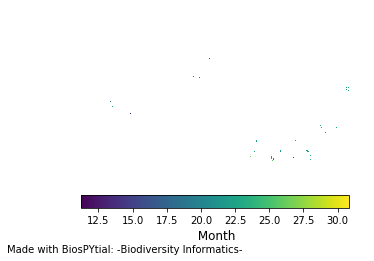

In [47]:
vertebrates.associatedData.raster_MeanTemperature.display_field()

### Interactive visualisation
As an alternative, we can export the raster object as an xarray instance for an interactive visu-
alisation using the Geoviews (http:geoviews.org) package. 
To export the associated raster data to an xarray object do:

In [48]:
meantemp = vertebrates.associatedData.raster_MeanTemperature.to_xarray()

For an interactive visualisation import the necessary packages and use:

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
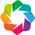

In [49]:
import geoviews as gv
from cartopy import crs
import geoviews.feature as gf
from geoviews import opts
gv.extension('bokeh')
opts.defaults(
    opts.Image(width=600, height=400, colorbar=True))


subset = meantemp.where(((meantemp.Longitude > -95) & (meantemp.Longitude < -89) & 
                     (meantemp.Latitude > 15) & (meantemp.Latitude < 19)),drop=True)
subset.name = meantemp.name
gvds = gv.Dataset(subset,crs=crs.PlateCarree())
#gv1 = gv.Dataset(meantemp,crs=crs.PlateCarree())
#image1 = gvds.to(gv.Image,['Longitude','Latitude']).opts(cmap=plt.cm.terrain)
image1 = gvds.to(gv.Image,['Longitude','Latitude']).opts(cmap=plt.cm.magma)


In [50]:
(gf.land * image1 * gf.ocean * gf.coastline * gf.borders ) 

:HoloMap   [Months]
   :Overlay
      .Land.I      :Feature   [Longitude,Latitude]
      .Image.I     :Image   [Longitude,Latitude]   (MeanTemp)
      .Ocean.I     :Feature   [Longitude,Latitude]
      .Coastline.I :Feature   [Longitude,Latitude]
      .Borders.I   :Feature   [Longitude,Latitude]

# Network visualisation and analysis
Each tree instance induces an acyclic graph. We can convert the tree into a networkx object
to visualise and analyse its network properties. To do this, we simply need to use the method:
tree.toNetworkx(depth_level=[k]) where k is the taxonomic level to reach in the tree, 0 for
root 7 for species level.

## Visualisation
A method for interactive visualisation has been developed using the Holoviews ( h ttps://holoviews.org)
framework. To do we need to invoke the method:




In [51]:
## Plot the Tree
from drivers.tools import to_interactivePlot
network = to_interactivePlot(threatened_tree,label_depth=8)
network['labels'] * network['graph']

:Overlay
   .Labels.I :Labels   [x,y]   (namelabel,freq,angle,namesize,level)
   .Graph.I  :Graph   [start,end]

### Visualising the Parrots tree


In [52]:
network = to_interactivePlot(parrots,label_depth=8)
network['labels'] * network['graph']

:Overlay
   .Labels.I :Labels   [x,y]   (namelabel,freq,angle,namesize,level)
   .Graph.I  :Graph   [start,end]

### Visualising the mammals tree

In [53]:
network = to_interactivePlot(mammals,label_depth=8)
network['labels'] * network['graph']

:Overlay
   .Labels.I :Labels   [x,y]   (namelabel,freq,angle,namesize,level)
   .Graph.I  :Graph   [start,end]

### Graph algorithms 
The *TreeNeo* structures are particular cases of graph traversals. As such, they can be analysed with graph theoretic methods. The library `NetworkX` (https://networkx.github.io/) is a Python package designed for analysing structure, dynamics and functions of complex networks. It includes standard graph algorithms and analysis measures as well as tools for import and export to other standard formats.
We can convert a *TreeNeo* using the method: `toNetworkx(depth_level )`. 
where depth_level is the depth of the graph to be generated.


In the next example we convert the `threatened_tree` to a NetworkX object and use this to calculate its corresponding adjancecy matrix. 


In [54]:
threatened_graph = threatened_tree.toNetworkx(depth_level=7)

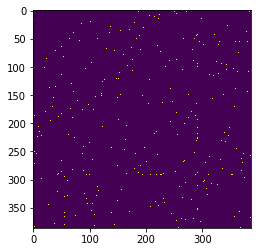

In [55]:
from networkx import adjacency_matrix
M = adjacency_matrix(threatened_graph)
# uncomment this to plot the matrix
plt.imshow(M.todense())

Representing *TreeNeo* objects into NetworkX graphs brings new possibilities for analyses and modelling.
We hope this example will awake the spirit of the reader to explore the potential of representing data as complex graph structures.